# ISEL - CPS 
## Semestre 2024/25
# <br>
###  <center> Trabalho Prático 1 - Comunicações Digitais</center>
# </br>


Trabalho realizado por:
* Tiago Alexandre, numero: <b> 50738 </b>
* Daniel Salgueiro, numero: <b> 50789 </b>

<b> Turma 31N - André Lourenço </b>

<b>A entrega deve ser realizada no moodle associado a cada turma</b>

<b> Nota: na entrega o nome do ficheiro deve ser alterado para conter o número dos alunos do grupo:</b>
CPS_T1_Num1_Num2_Num3.ipynb

Devem usar o style guide PEP8: https://peps.python.org/pep-0008/


# Introdução
A figura abaixo representa o esquema típico do processo de envio e recepção de informação usando modulações
digitais.

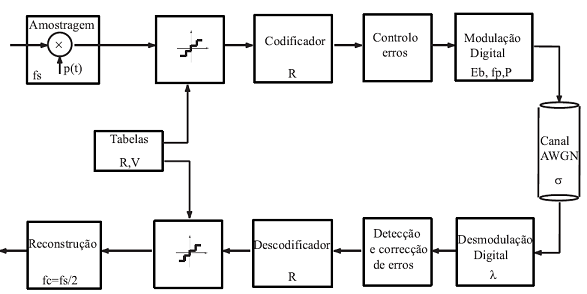

Neste 1º trabalho foca-se os blocos da Codificação, dos Códigos Detectores e Correctores de Erros e Modulações Digitais. O bloco da Quantificação não consta neste trabalho.

O trabalho contempla a implementação da componente do emissor e do receptor, sendo objetivo enviar ficheiros entre o emissor e o receptor.



# A. Codificação/ Descodificação

Construa uma função Python que dado um Numpy array (com dimensão  𝑁 ) com valores inteiros, retorne um Numpy array (com dimensão  𝑁.𝑅×1 ) com os mesmos valores convertidos para binário. Para facilitar a realização do processamento nos blocos subsequentes aconselha-se a que cada bit esteja guardado individualmente. Esta função ainda deve receber como parâmetros de entrada o número de bits ( 𝑅 ) a usar na conversão de cada inteiro.

In [2]:
import numpy as np
import matplotlib.pyplot as plt

def Codific(arr_signal_quantized,R):
    arr_binary_flat = []
    N = len(arr_signal_quantized) # N é a len porque é a dimensão do array
    arr_binary = np.zeros((N, R), dtype=int) # criação do array dos int's passados a binário
                                             # cria uma lista de N linhas e R colunas 
                                             # e obriga os valores gaurdados a serem int's(dtype=int)
    for i in range (N): #percore a len do array
        binary_str = np.binary_repr(arr_signal_quantized[i], width = R) # usa a função numpy np.binary_repr
                                                                        # esta função recebe um int (arr_signal_quantized[i]) 
                                                                        # e uma width do int em binário(width = R)
                                                                        # e devolve uma string do int em binário
        for j in range (R): # percorre as colunas do array
            arr_binary[i, j] = int(binary_str[j]) # para cada i e j devolve o int em binário
                                                  # e obriga que este binário seja do tipo int "int(...)"
    arr_binary_flat = arr_binary.flatten()
    return arr_binary_flat

In [3]:
array1 = np.array([1,2,3,4,5])
R = 3
Codific(array1, R)

array([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1])

Construa uma função que dado um Numpy array com valores dos bits, faça a conversão para inteiros (considerando R bits).

In [4]:
def Descodific(arr_binary,R):
    arr_int = np.array([])

    arr_binary_reshaped = arr_binary.reshape(-1, R) # Esta função dá reshape de maneira que o array esteja só em uma linha
    
    arr_int = np.dot(arr_binary_reshaped, 2 ** np.arange(R)[::-1]) # o np.dot multiplica os arrays
                                                                   # o np.arange(R) cria um array de números inteirosque vão de 0 até R - 1
                                                                   # o [::-1] inverte o array
                                                                   # o 2** eleva cada elemento do array por 2
                                                                   # o resultado vai ser um array = [8, 4, 2, 1]
    max_val = 2 ** (R - 1)  # Este max_val representa o máximo valor positivo possível de obter com R bits
    arr_int[arr_int >= max_val] -= 2 ** R # Para valores que sejam muito altos , retira 2^R para poder representar o valor negativo

    return arr_int

In [5]:
array2 = np.array([1,0,0,0,1,1,1,1])
Descodific(array2,4)

array([-8, -1])

Com base nas funções já implementadas, faça a codificação e descodificação PCM uniforme do sinal de áudio previamente gravado. Use para o efeito R=3, 5 e 8.

In [6]:
from scipy.io import wavfile
#Resposta:
samplerate, audio_data = wavfile.read('FalaSala.wav')
print("20 primeiras samples do audio original:")
print(audio_data[:20])

print('-----------------------------------------------------------------------------')

R = 3
audio_binary = Codific(audio_data[:20], R)
print("Audio codificado com R = 3:")
print(audio_binary)
audio_decoded = Descodific(audio_binary, R)
print("Audio descodificado com R = 3:")
print(audio_decoded)

print('-----------------------------------------------------------------------------')

R = 5
audio_binary = Codific(audio_data[:20], R)
print("Audio codificado com R = 5:")
print(audio_binary)
audio_decoded = Descodific(audio_binary, R)
print("Audio descodificado com R = 5:")
print(audio_decoded)

print('-----------------------------------------------------------------------------')

R = 8
audio_binary = Codific(audio_data[:20], R)
print("Audio codificado com R = 8:")
print(audio_binary)
audio_decoded = Descodific(audio_binary, R)
print("Audio descodificado com R = 8:")
print(audio_decoded)

20 primeiras samples do audio original:
[-136 -115 -106 -119 -135 -130 -117 -111  -86  -72  -75  -92 -100  -63
  -34    4   33   -2  -24  -11]
-----------------------------------------------------------------------------
Audio codificado com R = 3:
[1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1
 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1]
Audio descodificado com R = 3:
[-3 -4 -4 -4 -3 -3 -4 -4 -3 -3 -3 -3 -4 -4 -3 -4 -4 -2 -3 -3]
-----------------------------------------------------------------------------
Audio codificado com R = 5:
[1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 0
 0 1 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1
 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1]
Audio descodificado com R = 5:
[ -9 -15 -14 -15  -9  -9 -15 -14 -11  -9 -10 -12 -13 -16  -9   4 -16  -2
 -12 -11]
-----------------------------------------------------------------------------
Audio codificado com R = 8:
[1 0 

C:\Users\Tiago\AppData\Local\Temp\ipykernel_19600\2641911772.py:11: DeprecationWarning: Insufficient bit width provided. This behavior will raise an error in the future.
  binary_str = np.binary_repr(arr_signal_quantized[i], width = R) # usa a função numpy np.binary_repr


In [7]:
# Nós sabemos que não foi pedido o R=9 mas decidimos introduzir para poder explicar o porque de os valores não estarem corretos no R=8
# Alguns dos valores são muito altos, por serem maoires que 2^8 = 128, por exemplo o -136, -135 e -130 por isso a função não fornece o valor negativo correto.
# Mas se utilizarmos o R = 9 a função devolve os valores corretos, por já ser 2^9 = 256.
print("20 primeiras samples do audio original:")
print(audio_data[:20])
R = 9
audio_binary = Codific(audio_data[:20], R)
print("Audio codificado com R = 9:")
print(audio_binary)
audio_decoded = Descodific(audio_binary, R)
print("Audio descodificado com R = 9:")
print(audio_decoded)


20 primeiras samples do audio original:
[-136 -115 -106 -119 -135 -130 -117 -111  -86  -72  -75  -92 -100  -63
  -34    4   33   -2  -24  -11]
Audio codificado com R = 9:
[1 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 1 1
 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1
 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 1 0
 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1
 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 1]
Audio descodificado com R = 9:
[-136 -115 -106 -119 -135 -130 -117 -111  -86  -72  -75  -92 -100  -63
  -34    4   33   -2  -24  -11]


# B.  Deteção e Correção de erros 

Construa uma função que implemente um código de deteção de erros baseado no código de bit paridade. Considere que a função recebe um blocos de M-1 bits de mensagem e produz um bloco de M bits (incluindo o bit de paridade).

In [8]:
import numpy as np
import matplotlib.pyplot as plt

def BitParidade(arr_bits, M):
    bitParidade = np.sum(arr_bits) % 2
    arr_paridade = np.append(arr_bits, bitParidade)
    return arr_paridade

Construa uma função que dado um Numpy array M bits detecte possíveis erros, sendo o resultado os bits de mensagem e um boleano com a deteção de erro.

In [9]:
def DetetorCorretor(arr_bits):  
    return arr_bits[:-1], np.sum(arr_bits[:-1]) % 2 != arr_bits[len(arr_bits) - 1]

Faça um conjunto de testes para verificar o correto funcionamento das funções.

In [10]:
mensagem = np.array([1, 0, 1, 1])

menParidade = BitParidade(mensagem, len(mensagem + 1))
menOriginal, detErro = DetetorCorretor(menParidade)

print("Mensagem com Paridade: ", menParidade)
print("Mensagem Original: ", menOriginal, "Erro:", detErro)

menParidade[0] = 0
menOriginal, detErro = DetetorCorretor(menParidade)
print("Mensagem sem Paridade: ", menOriginal)
print("Mensagem Original: ", menOriginal, "Erro:", detErro)


Mensagem com Paridade:  [1 0 1 1 1]
Mensagem Original:  [1 0 1 1] Erro: False
Mensagem sem Paridade:  [0 0 1 1]
Mensagem Original:  [0 0 1 1] Erro: True


# C.  Modulação Digital


Construa uma função que simule a modulação digital 8-QAM. Esta função recebe como parâmetro de entrada um array de bits e retorna um array, simulando o sinal analógico modulado a transmitir. A constelação a implementar será apresentada por cada docente.

Dado que o sinal modulado é simulado (um sinal discreto), é necessário que a função receba ainda como parâmetros de entrada a Frequência de Amostragem, $Fs$, a frequência da portadora, $f_{c}$ e o tempo associado a cada simbolo, $t_{simbolo}$. Esta função recebe ainda os parametros que forem necessários para definir a constelação (energia média por bit, $E_b$, ou outro(s) relacionados). 

In [11]:
import numpy as np
import matplotlib.pyplot as plt

# Definindo amplitudes para cada grupo de pontos
A = 2  # Amplitude para pontos mais distantes do centro
B = 1  # Amplitude para pontos mais próximos do centro

def mod_QAM(bits, fs=1000, fc=100, tsimbolo=0.001):
    # Redimensionar os bits para grupos de 3
    bits = bits.reshape(-1, 3)
    
    # Definindo ângulos para os pontos da constelação
    ang_A = [0, np.pi/2, np.pi, 3 * np.pi/2]  # Ângulos para amplitude A
    ang_B = [np.pi/4, 3 * np.pi/4, 5 * np.pi/4, 7 * np.pi/4]                  # Ângulos para amplitude B

    # Gerando os pontos da constelação
    pontos_A = [A * (np.cos(angle) + 1j * np.sin(angle)) for angle in ang_A]
    pontos_B = [B * (np.cos(angle) + 1j * np.sin(angle)) for angle in ang_B]

    # Criando um dicionário de mapeamento de bits para pontos da constelação
    mapeamento_bits = {
        (0, 0, 0): pontos_A[0],
        (0, 0, 1): pontos_A[1],
        (0, 1, 0): pontos_A[2],
        (0, 1, 1): pontos_A[3],
        (1, 0, 0): pontos_B[0],
        (1, 0, 1): pontos_B[1],
        (1, 1, 0): pontos_B[2],
        (1, 1, 1): pontos_B[3]
    }

    # Tempo para um símbolo
    t = np.arange(0, tsimbolo, 1/fs)
    sinais = []
    
    for simbolo in bits:
        # Obter o ponto da constelação a partir do mapeamento de bits
        ponto_constelacao = mapeamento_bits[tuple(simbolo)]
        
        # Obtenha as componentes I e Q do ponto da constelação
        I, Q = np.real(ponto_constelacao), np.imag(ponto_constelacao)

        # Gera os sinais em fase (I) e quadratura (Q) modulados
        carrier_I = I * np.cos(2 * np.pi * fc * t)
        carrier_Q = Q * np.sin(2 * np.pi * fc * t)

        # Símbolo modulado
        modSimbolo = carrier_I + carrier_Q
        sinais.append(modSimbolo)
    
    # Concatenar todos os símbolos modulados
    sinal = np.concatenate(sinais)
    
    return sinal

Construa uma função que simule, no receptor, um filtro adaptado (desmodulação). Este deve receber um array com o sinal modulado com ruído e deve retornar um array com a sequência binária correspondente.

In [12]:
#resposta
def receptor(sinal, fs= ..., fc = ..., tsimbolo = ...):

    ang_A = [np.pi/4, 3 * np.pi/4, 5 * np.pi/4, 7 * np.pi/4]
    ang_B = [0, np.pi/2, np.pi, 3 * np.pi/2]
    pontos_A = [A * (np.cos(angle) + 1j * np.sin(angle)) for angle in ang_A]
    pontos_B = [B * (np.cos(angle) + 1j * np.sin(angle)) for angle in ang_B]
    constelacao = np.array(pontos_A + pontos_B)

    t = np.arange(0, tsimbolo, 1/fs)
    amostrasPorSimbolo = int(tsimbolo * fs)
    numSimbolos = len(sinal) // amostrasPorSimbolo
    bits_Estimados = []

    for i in range(numSimbolos):
        segmSimbolo = sinal[i * amostrasPorSimbolo : (i + 1) * amostrasPorSimbolo]
        
        #Desmodulação dos componentes I e Q
        comp_I = np.mean(segmSimbolo * np.cos(2 * np.pi * fc * t))
        comp_Q = np.mean(segmSimbolo * np.sin(2 * np.pi * fc * t))
        
        # Encontrar o símbolo mais próximo na constelação
        distancias = np.abs(constelacao - (comp_I + 1j * comp_Q))  # Distância Euclidiana
        indice_menor_distancia = np.argmin(distancias)  # Índice do símbolo mais próximo
        simbolo_proximo = constelacao[indice_menor_distancia]
        
        # Mapear os bits para o símbolo mais próximo
        bits = [1 if simbolo_proximo.real > 0 else 0, 
                1 if simbolo_proximo.imag > 0 else 0]
        bits_Estimados.extend(bits)
        
    return bits_Estimados

Considere que o canal segue o modelo de canal AWGN. 

Este pode ser implementado a partir da linha de código em baixo.  Recebe o sinal modulado (sinal_in), adiciona ruído, com uma determinada potência ${\sigma_n}^2$ (pot_noise) e devolve o sinal com ruído num array (sinal_out).

In [13]:
#sinal_in = mod_QAM()    implementar input
#pot_noise =             implementar potencia de ruido
def canal_AWGN(sinal_in, pot_noise): #Adiciona ruído branco gaussiano aditivo (AWGN) ao sinal
    sinal_out = sinal_in + np.sqrt(pot_noise) * np.random.randn(len(sinal_in))
    return sinal_out

#sinalRecebido = receptor(sinal_out, )

Construa uma função que calcule o BER teórico para a modulação implementada.

In [14]:
import scipy.special as sp  # Para a função erfc

def BER_teorico(snr_dB):
    M = 8  # Número de símbolos na constelação 8-QAM
    snr_linear = 10 ** (snr_dB / 10)  # Converter de dB para linear
    # Fórmula do BER teórico para 8-QAM com o complemento da função erro (erfc)
    BER_t = (4 / 3) * sp.erfc(np.sqrt((3 * snr_linear) / (M - 1)))
    return BER_t


# D. Avaliação do Sistema

Avalie todo o sistema de emissão e receção. Para isso deve medir experimentalmente e comparar, sempre que possível, com os valores teóricos, os seguintes índices:

    A SNR no canal e SNR na recepção;
    
    BER e percentagem de deteção de erros;
    
    Apresente a constelação antes e depois do sinal passar pelo canal.

Para o efeito deve atribuir diferentes valores aos parâmetros do sistema, de modo a traçar experimentalmente uma curva de BER em função do SNR.



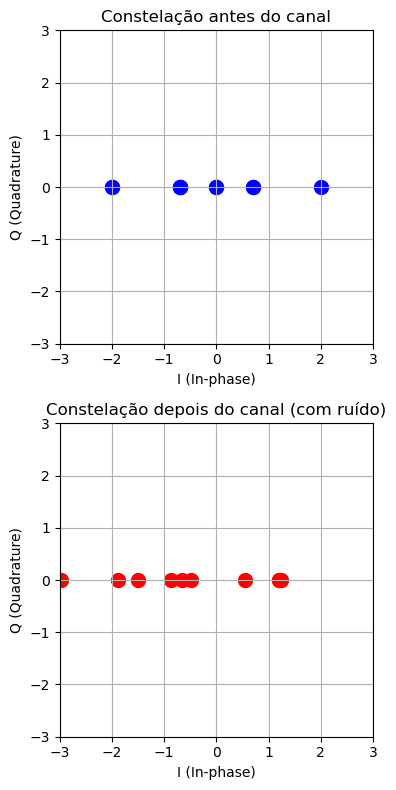

SNR (dB)   BER Experimental
------------------------------
0          0.500000
2          0.366667
4          0.500000
6          0.533333
8          0.600000
10         0.400000
12         0.433333
14         0.433333
16         0.366667
18         0.500000
-----------------------------------------------------------------------
SNR no Canal (dB)    SNR na Recepção (dB)
----------------------------------------
0                    2.72
2                    0.63
4                    4.15
6                    10.57
8                    10.21
10                   12.58
12                   14.27
14                   16.61
16                   21.53
18                   20.95


In [15]:
#resposta
# Parâmetros do teste
n_bits = 30  # Número de bits para a simulação
SNR_dB_values = np.arange(0, 20, 2)  # Valores de SNR (de 0 a 20 dB, com passo de 2)
fs = 1000  # Frequência de amostragem (exemplo)
fc = 100   # Frequência do portador (exemplo)
tsimbolo = 1e-3  # Período do símbolo (exemplo)

# Avaliação de desempenho com diferentes SNRs
BER_experimental = []
snr_recepcao = []


# Função para calcular o SNR
def calcular_snr(sinal_modulado, erro):
    # Potência do sinal modulado
    potencia_sinal = np.mean(np.abs(sinal_modulado)**2)
    # Potência do erro (ruído)
    potencia_ruido = np.mean(np.abs(erro)**2)
    # Calcular o SNR
    snr = 10 * np.log10(potencia_sinal / potencia_ruido)
    return snr

# Simulação
for snr_dB in SNR_dB_values:
    # Gerar sequência de bits aleatórios
    bits = np.random.randint(0, 2, n_bits)
    
    # Modulação 8-QAM
    sinal_modulado = mod_QAM(bits, fs, fc, tsimbolo)
    
    # Adicionar ruído AWGN ao sinal
    pot_noise = 10 ** (-snr_dB / 10)  # Potência do ruído para o SNR especificado
    sinal_com_ruido = canal_AWGN(sinal_modulado, pot_noise)
    
    # Calcular SNR no canal
    snr_canal = calcular_snr(sinal_modulado, sinal_com_ruido - sinal_modulado)
    snr_recepcao.append(snr_canal)

    # Demodulação (recepção)
    bits_estimados = receptor(sinal_com_ruido, fs, fc, tsimbolo)

    # Ajuste no número de bits estimados
    n_simbolos = len(bits_estimados) // 3
    bits_estimados = bits_estimados[:n_bits]

    if len(bits_estimados) < n_bits:
        bits_estimados = np.concatenate([bits_estimados, np.zeros(n_bits - len(bits_estimados))])

    # Calcular BER experimental
    erro = np.sum(bits != bits_estimados)
    taxa_erro = erro / n_bits
    BER_experimental.append(taxa_erro)

    # Mostrar constelação antes e depois do canal para o SNR = 0
    if snr_dB == 0:
        plt.figure(figsize=(20, 8))  # Aumentar o tamanho da figura para que fique mais larga

        # Antes do canal
        plt.subplot(2, 1, 1)
        plt.scatter(np.real(sinal_modulado), np.imag(sinal_modulado), color='blue', label='Antes do canal', s=100)  # Ajuste no tamanho do ponto
        plt.title("Constelação antes do canal")
        plt.xlabel("I (In-phase)")
        plt.ylabel("Q (Quadrature)")
        plt.grid(True)
        plt.xlim([-3, 3])
        plt.ylim([-3, 3])
        plt.gca().set_aspect('equal', adjustable='box')

        # Depois do canal
        plt.subplot(2, 1, 2)
        plt.scatter(np.real(sinal_com_ruido), np.imag(sinal_com_ruido), color='red', label='Depois do canal', s=100)  # Ajuste no tamanho do ponto
        plt.title("Constelação depois do canal (com ruído)")
        plt.xlabel("I (In-phase)")
        plt.ylabel("Q (Quadrature)")
        plt.grid(True)
        plt.xlim([-3, 3])
        plt.ylim([-3, 3])
        plt.gca().set_aspect('equal', adjustable='box')

        plt.tight_layout()
        plt.show()

# Exibir os valores de BER vs SNR em formato texto
print(f"{'SNR (dB)':<10} {'BER Experimental'}")
print("-" * 30)
# Iterar sobre os valores de SNR e BER
for snr_dB, ber in zip(SNR_dB_values, BER_experimental):
    print(f"{snr_dB:<10} {ber:.6f}")

print('-----------------------------------------------------------------------')

# Exibir os valores de SNR no canal e SNR na recepção de forma mais clara
print(f"{'SNR no Canal (dB)':<20} {'SNR na Recepção (dB)'}")
print("-" * 40)
# Iterar sobre os valores de SNR no canal e SNR na recepção
for snr_dB, snr_rx in zip(SNR_dB_values, snr_recepcao):
    print(f"{snr_dB:<20} {snr_rx:.2f}")

# E. Wav
Simule o sistema com um sinal wav e apresente tempos de processamento para cada um dos blocos.

In [24]:
#resposta

import scipy.io.wavfile as wav
import numpy as np
import time
from IPython.display import Audio  # Usado para reprodução de áudio no Jupyter

# Carregar o arquivo WAV
nome_arquivo = 'FalaSala.wav'  # Substitua com o nome do seu arquivo WAV
fs, sinal_original = wav.read(nome_arquivo)

# Gerar sequência de bits aleatória
n_bits = len(sinal_original) // 3 * 3  # Certificar-se de que é múltiplo de 3
bits = np.random.randint(0, 2, n_bits)

# 1. Modulação do sinal com amplitude reduzida
A = 0.5  # Reduzido para amplitude menor
B = 0.25  # Reduzido para amplitude menor

start_time = time.time()
sinal_modulado = mod_QAM(bits, fs=fs, fc=100, tsimbolo=0.001)
mod_time = time.time() - start_time

# 2. Adicionar ruído AWGN com SNR mais alto
snr_dB = 30  # Aumentar o valor de SNR para reduzir o ruído
pot_noise = 10 ** (-snr_dB / 10)
start_time = time.time()
sinal_com_ruido = canal_AWGN(sinal_modulado, pot_noise)
canal_time = time.time() - start_time

# Exibir tempos de processamento
print(f"Tempo de modulação: {mod_time:.4f} segundos")
print(f"Tempo de envio pelo canal (AWGN): {canal_time:.4f} segundos")

# **Tornar os sinais modulado e com ruído mais parecidos com o original e mais baixos**
# Reduzir o volume do áudio modulado e do áudio com ruído
fator_volume = 0.2  # Fator para reduzir o volume, podendo ser ajustado conforme necessário

sinal_modulado = sinal_modulado * fator_volume
sinal_com_ruido = sinal_com_ruido * fator_volume

# Reproduzir os sinais processados
# Reproduz o sinal original, modulado e com ruído no Jupyter
Audio1 = Audio(sinal_original, rate=fs)  # Reproduzir o sinal original
Audio2 = Audio(sinal_modulado, rate=fs)  # Reproduzir o sinal modulado
Audio3 = Audio(sinal_com_ruido, rate=fs)  # Reproduzir o sinal com ruído



Tempo de modulação: 0.8213 segundos
Tempo de envio pelo canal (AWGN): 0.0977 segundos


In [25]:
print('Audio Original:')
Audio1

Audio Original:


In [28]:
# Não conseguimos que o audio modulado e o audio com suído ficassem mais suaves por isso aconcelhamos a diminuição do volume dos mesmos

In [ ]:
print('Audio Modulado:')
Audio2

Audio Modulado:


In [27]:
print('Audio com Ruído:')
Audio3

Audio com Ruído:
